# **Downloading and preprocessing on Datasets.**

In [1]:
import requests
from tqdm import tqdm
BASE_URL = 'http://yuhang.rsise.anu.edu.au/download/'

In [2]:
list_links = []
for p in range(1, 11):
  list_links.append(f'db{p}.zip')

In [3]:
for link in list_links:
  url = BASE_URL + link
  !wget {url}
  

--2020-10-22 11:59:15--  http://yuhang.rsise.anu.edu.au/download/db1.zip
Resolving yuhang.rsise.anu.edu.au (yuhang.rsise.anu.edu.au)... 150.203.208.64
Connecting to yuhang.rsise.anu.edu.au (yuhang.rsise.anu.edu.au)|150.203.208.64|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 192894514 (184M) [application/zip]
Saving to: ‘db1.zip’

db1.zip             100%[===================>] 183.96M  2.17MB/s    in 35s     

2020-10-22 11:59:51 (5.33 MB/s) - ‘db1.zip’ saved [192894514/192894514]

--2020-10-22 11:59:51--  http://yuhang.rsise.anu.edu.au/download/db2.zip
Resolving yuhang.rsise.anu.edu.au (yuhang.rsise.anu.edu.au)... 150.203.208.64
Connecting to yuhang.rsise.anu.edu.au (yuhang.rsise.anu.edu.au)|150.203.208.64|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 203405885 (194M) [application/zip]
Saving to: ‘db2.zip’

db2.zip             100%[===================>] 193.98M  3.12MB/s    in 59s     

2020-10-22 12:00:51 (3.30 MB/s) - ‘db2.zip’ s

In [4]:
!wget https://raw.githubusercontent.com/ParallelDots/generic-sku-detection-benchmark/master/annotations/WebMarket/WebMarket_coco_gt_object.csv

--2020-10-22 12:33:52--  https://raw.githubusercontent.com/ParallelDots/generic-sku-detection-benchmark/master/annotations/WebMarket/WebMarket_coco_gt_object.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4203922 (4.0M) [text/plain]
Saving to: ‘WebMarket_coco_gt_object.csv’

WebMarket_coco_gt_o 100%[===================>]   4.01M  --.-KB/s    in 0.1s    

2020-10-22 12:33:53 (30.1 MB/s) - ‘WebMarket_coco_gt_object.csv’ saved [4203922/4203922]



In [5]:
!ls

db10.zip  db2.zip  db4.zip  db6.zip  db8.zip  sample_data
db1.zip   db3.zip  db5.zip  db7.zip  db9.zip  WebMarket_coco_gt_object.csv


In [6]:
for link in list_links:
  !unzip {link}

Archive:  db1.zip
  inflating: db1/db1.jpg             
  inflating: db1/db10.jpg            
  inflating: db1/db100.jpg           
  inflating: db1/db101.jpg           
  inflating: db1/db102.jpg           
  inflating: db1/db103.jpg           
  inflating: db1/db104.jpg           
  inflating: db1/db105.jpg           
  inflating: db1/db106.jpg           
  inflating: db1/db107.jpg           
  inflating: db1/db108.jpg           
  inflating: db1/db109.jpg           
  inflating: db1/db11.jpg            
  inflating: db1/db110.jpg           
  inflating: db1/db111.jpg           
  inflating: db1/db112.jpg           
  inflating: db1/db113.jpg           
  inflating: db1/db114.jpg           
  inflating: db1/db115.jpg           
  inflating: db1/db116.jpg           
  inflating: db1/db117.jpg           
  inflating: db1/db118.jpg           
  inflating: db1/db119.jpg           
  inflating: db1/db12.jpg            
  inflating: db1/db120.jpg           
  inflating: db1/db121.jpg      

In [7]:
for link in list_links:
  !rm -r {link}

In [8]:
!ls

db1   db2  db4	db6  db8  sample_data
db10  db3  db5	db7  db9  WebMarket_coco_gt_object.csv


# **Installing Detectron2 and dependencies**

In [9]:
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

1.6.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [10]:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
     |████████████████████████████████| 6.6MB 4.1MB/s 
     |████████████████████████████████| 2.2MB 5.3MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201020-cp36-none-any.whl size=44210 sha256=bf3a501313afd371b4860c1972c999ec0587624e6fc4baf47d714349b9ad2439
  Stored in directory: /root/.cache/pip/wheels/71/6c/b5/198f89a5c5f127327730248cc623e5a307ad11ed287c3fe391
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [1]:
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import glob
from google.colab.patches import cv2_imshow
import os
import ntpath
import numpy as np
import cv2
import random
import itertools
import pandas as pd
from tqdm import tqdm
import urllib
import json
import PIL.Image as Image
import tensorboard

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode

import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc

%matplotlib inline
%config InlineBackend.figure_format='retina'

sns.set(style='whitegrid', palette='muted', font_scale=1.2)

HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]

sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))

rcParams['figure.figsize'] = 12, 8


In [3]:
folders = []
for p in range(1, 11):
  folders.append(f'db{p}')

In [4]:
!ls

'=2.0.1'   db10   db3   db5   db7   db9		  WebMarket_coco_gt_object.csv
 db1	   db2	  db4   db6   db8   sample_data


In [5]:
annote = pd.read_csv('WebMarket_coco_gt_object.csv')

In [6]:
annote.head()

,image_name,x1,y1,x2,y2,class
0,db1.jpg,1105,919,1315,1127,object
1,db1.jpg,191,1242,398,1469,object
2,db1.jpg,1587,697,1906,761,object
3,db1.jpg,1541,442,1845,541,object
4,db1.jpg,1252,505,1398,761,object


In [7]:
annote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118388 entries, 0 to 118387
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   image_name  118388 non-null  object
 1   x1          118388 non-null  int64 
 2   y1          118388 non-null  int64 
 3   x2          118388 non-null  int64 
 4   y2          118388 non-null  int64 
 5   class       118388 non-null  object
dtypes: int64(4), object(2)
memory usage: 5.4+ MB


# **Preparing datasets**

In [8]:
dataset = pd.DataFrame()
for dir in list_links:
  dir_name = dir.split('.')[0]
  for img_name in os.listdir(dir_name):
    temp_df = annote[annote['image_name'] == img_name]
    temp_df['file_path'] = os.path.join(dir_name, img_name)
    dataset = pd.concat([dataset, temp_df]) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [9]:
dataset.head()

,image_name,x1,y1,x2,y2,class,file_path
10495,db63.jpg,2048,753,2258,1047,object,db1/db63.jpg
10496,db63.jpg,1660,1177,1963,1497,object,db1/db63.jpg
10497,db63.jpg,523,769,808,1045,object,db1/db63.jpg
10498,db63.jpg,1485,782,1768,1040,object,db1/db63.jpg
10499,db63.jpg,1267,397,1388,621,object,db1/db63.jpg


In [10]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 118388 entries, 10495 to 26626
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   image_name  118388 non-null  object
 1   x1          118388 non-null  int64 
 2   y1          118388 non-null  int64 
 3   x2          118388 non-null  int64 
 4   y2          118388 non-null  int64 
 5   class       118388 non-null  object
 6   file_path   118388 non-null  object
dtypes: int64(4), object(3)
memory usage: 7.2+ MB


In [11]:
os.makedirs('objects', exist_ok = True)

In [12]:
unique_img = dataset.image_name.unique()

In [13]:
dataset = dataset.rename(columns=  {'class' : 'class_name'})

In [14]:
train_files = set(np.random.choice(unique_img, int(len(unique_img) * 0.90), replace=False))
train_df = dataset[dataset.image_name.isin(train_files)]
test_df = dataset[~dataset.image_name.isin(train_files)]

In [15]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 106097 entries, 10495 to 26626
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   image_name  106097 non-null  object
 1   x1          106097 non-null  int64 
 2   y1          106097 non-null  int64 
 3   x2          106097 non-null  int64 
 4   y2          106097 non-null  int64 
 5   class_name  106097 non-null  object
 6   file_path   106097 non-null  object
dtypes: int64(4), object(3)
memory usage: 6.5+ MB


In [16]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12291 entries, 6644 to 28434
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_name  12291 non-null  object
 1   x1          12291 non-null  int64 
 2   y1          12291 non-null  int64 
 3   x2          12291 non-null  int64 
 4   y2          12291 non-null  int64 
 5   class_name  12291 non-null  object
 6   file_path   12291 non-null  object
dtypes: int64(4), object(3)
memory usage: 768.2+ KB


In [17]:
classes = dataset.class_name.unique().tolist()

In [18]:
def create_dataset_dicts(df, classes):
  dataset_dicts = []
  for image_id, img_name in enumerate(df.image_name.unique()):

    record = {}

    image_df = df[df.image_name == img_name]

    record["file_name"] = image_df.file_path.values[0]
    record["image_id"] = image_id
    record["height"], record["width"] = cv2.imread(image_df.file_path.values[0]).shape[:2]

    objs = []
    for _, row in image_df.iterrows():

      x1 = int(row.x1)
      y1 = int(row.y1)
      x2 = int(row.x2)
      y2 = int(row.y2)

      poly = [
          (x1, y1), (x2, y1), 
          (x2, y2), (x1, y2)
      ]
      poly = list(itertools.chain.from_iterable(poly))

      obj = {
        "bbox": [x1, y1, x2, y2],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [poly],
        "category_id": classes.index(row.class_name),
      }
      objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)
  return dataset_dicts

In [19]:
for d in ["train", "val"]:
  DatasetCatalog.register("objects_" + d, lambda d=d: create_dataset_dicts(train_df if d == "train" else test_df, classes))
  MetadataCatalog.get("objects_" + d).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("objects_train")

# **Visualizing training dataset**

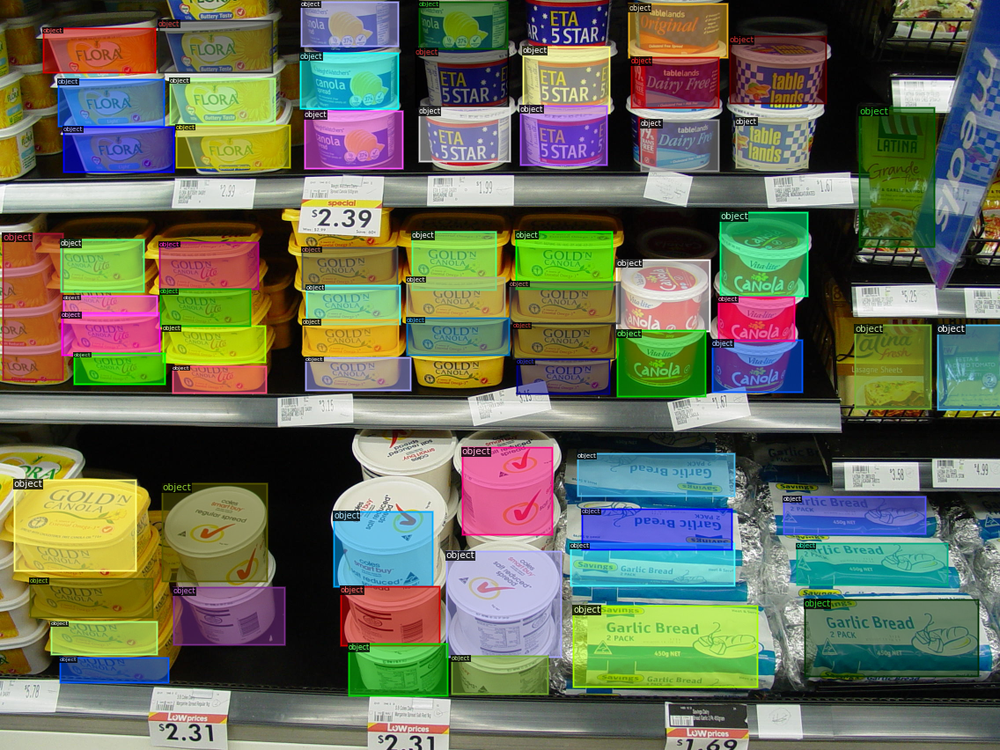

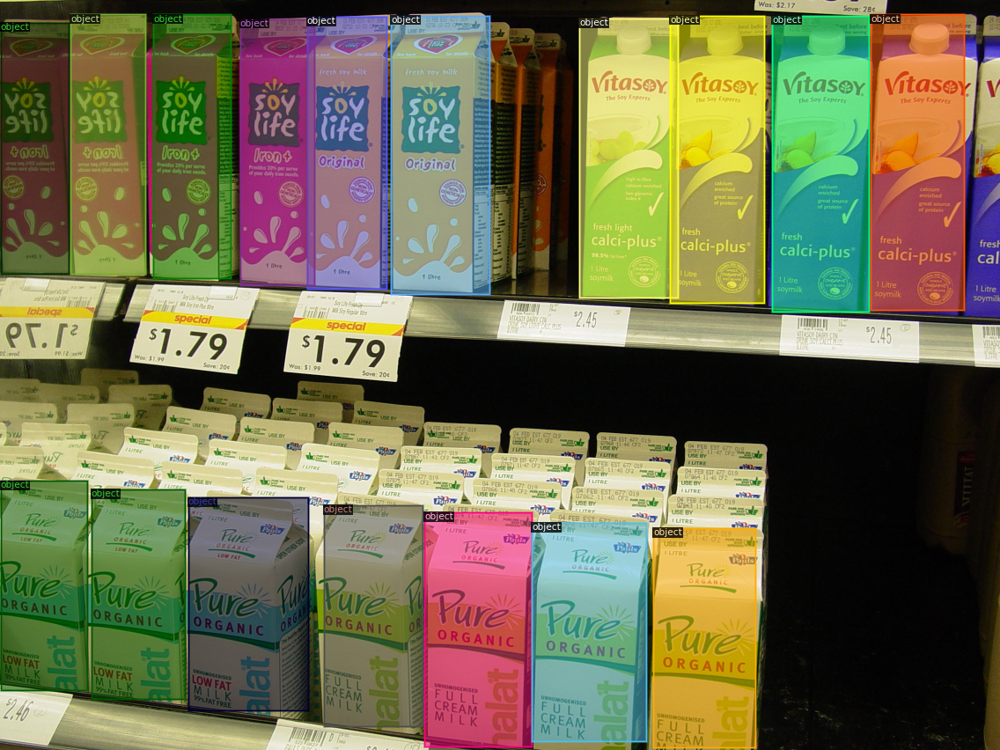

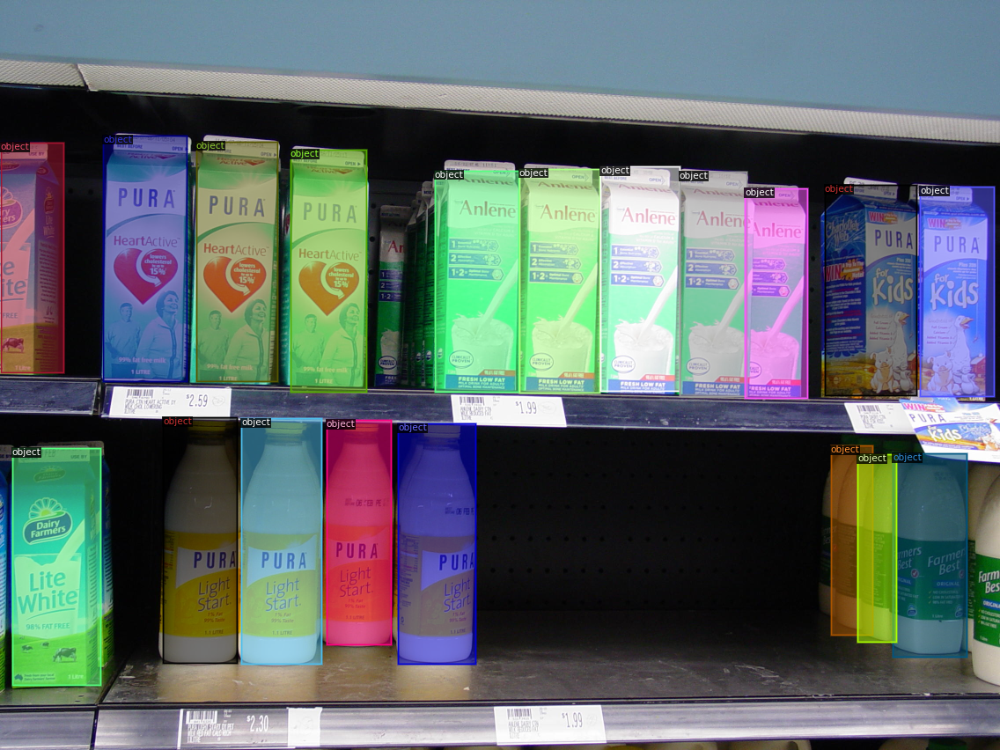

In [20]:
dataset_dicts = create_dataset_dicts(train_df[:300], classes)
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [21]:
class CocoTrainer(DefaultTrainer):
  
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

# **Model building and Training**

In [22]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("objects_train",)
cfg.DATASETS.TEST = ("objects_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001 
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000   
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  
cfg.TEST.EVAL_PERIOD = 500
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[10/22 12:44:16 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_2d9806.pkl: 431MB [00:05, 75.1MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[10/22 12:47:57 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:766.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:331: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python

[10/22 12:48:18 d2.utils.events]:  eta: 0:31:17  iter: 19  total_loss: 2.656  loss_cls: 0.707  loss_box_reg: 0.727  loss_mask: 0.696  loss_rpn_cls: 0.364  loss_rpn_loc: 0.181  time: 0.9597  data_time: 0.0686  lr: 0.000020  max_mem: 6138M
[10/22 12:48:37 d2.utils.events]:  eta: 0:31:15  iter: 39  total_loss: 2.283  loss_cls: 0.644  loss_box_reg: 0.747  loss_mask: 0.622  loss_rpn_cls: 0.179  loss_rpn_loc: 0.150  time: 0.9578  data_time: 0.0063  lr: 0.000040  max_mem: 6138M
[10/22 12:48:56 d2.utils.events]:  eta: 0:31:07  iter: 59  total_loss: 2.096  loss_cls: 0.558  loss_box_reg: 0.750  loss_mask: 0.517  loss_rpn_cls: 0.126  loss_rpn_loc: 0.158  time: 0.9594  data_time: 0.0059  lr: 0.000060  max_mem: 6138M
[10/22 12:49:15 d2.utils.events]:  eta: 0:30:40  iter: 79  total_loss: 1.978  loss_cls: 0.512  loss_box_reg: 0.750  loss_mask: 0.434  loss_rpn_cls: 0.096  loss_rpn_loc: 0.137  time: 0.9591  data_time: 0.0060  lr: 0.000080  max_mem: 6138M
[10/22 12:49:34 d2.utils.events]:  eta: 0:30:17 

In [23]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# **Predicting on Test dataset.**

In [24]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

# **Visualizing Test results.**

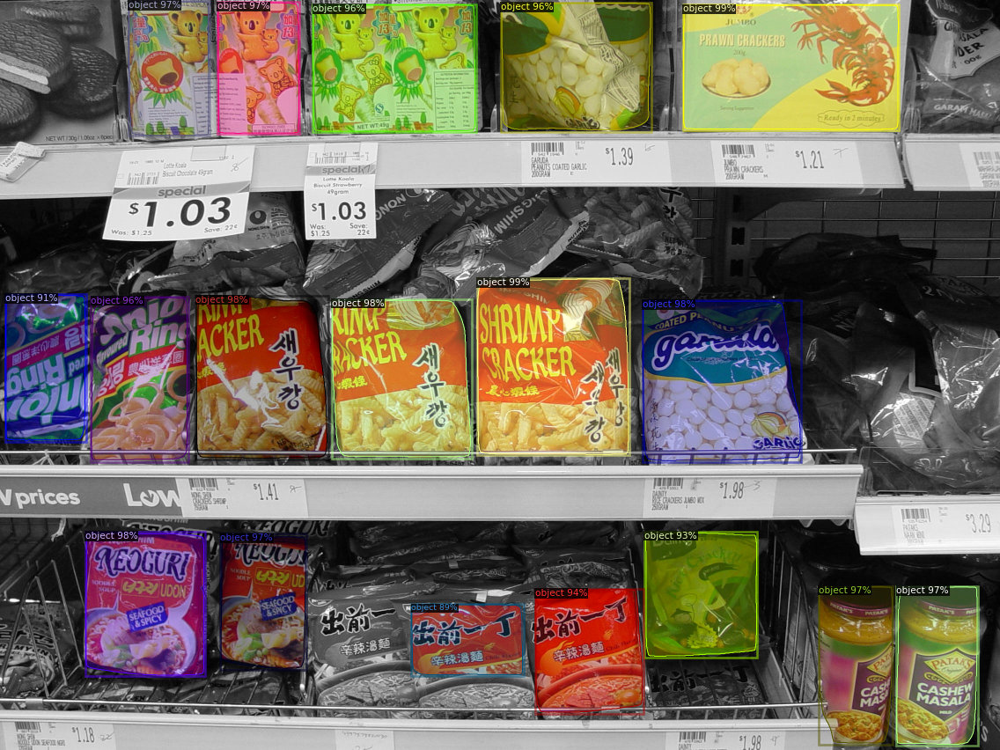

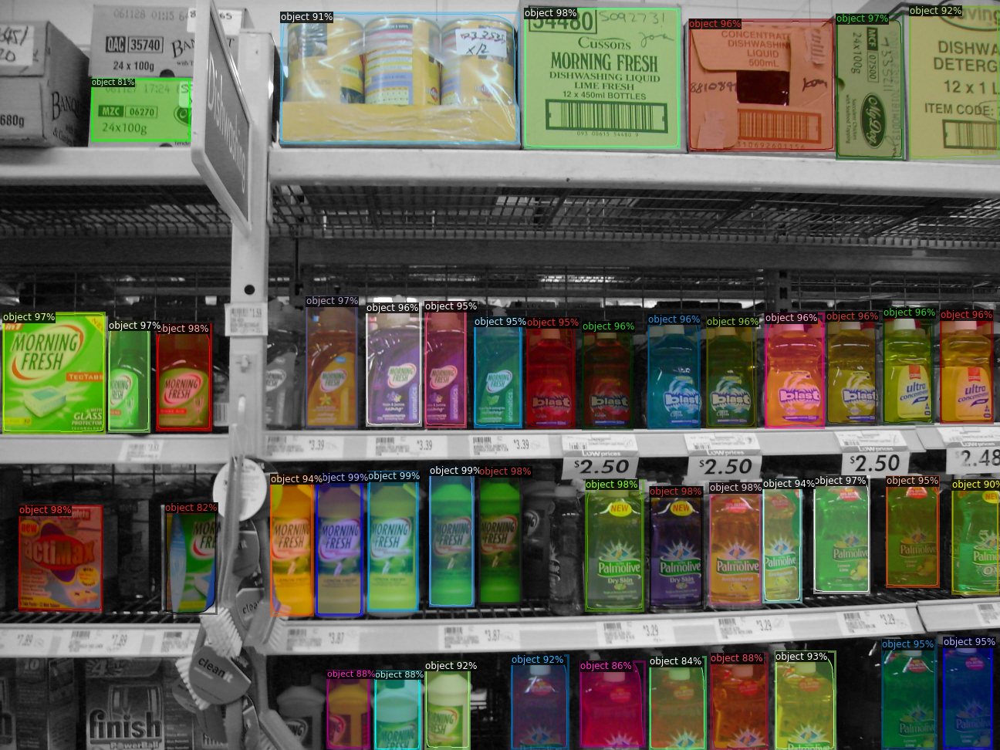

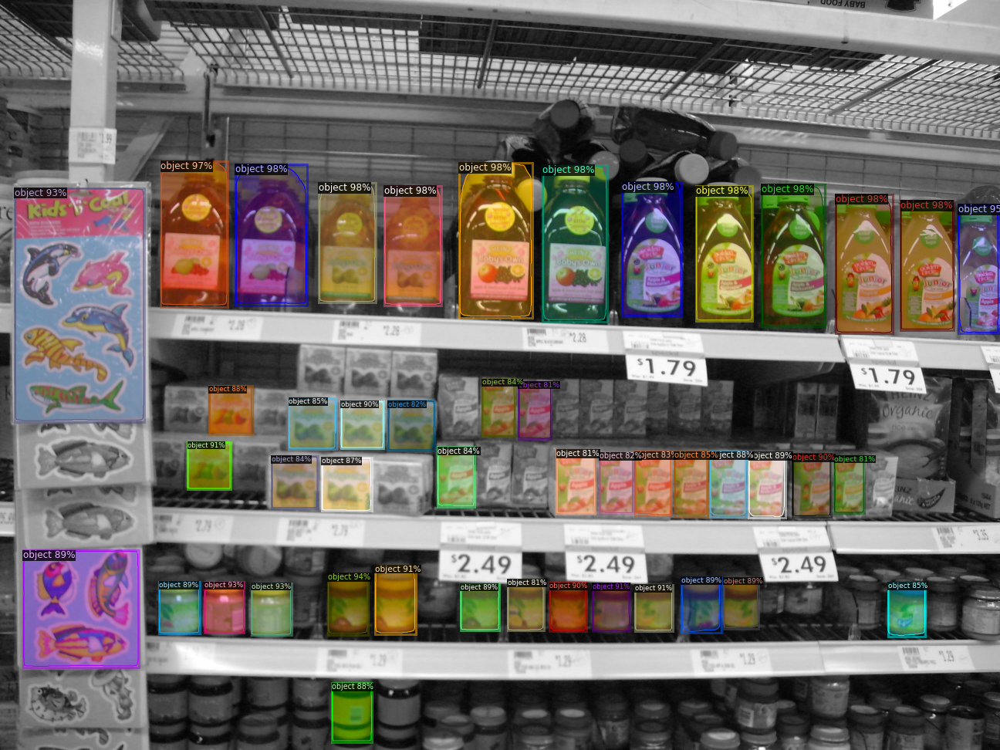

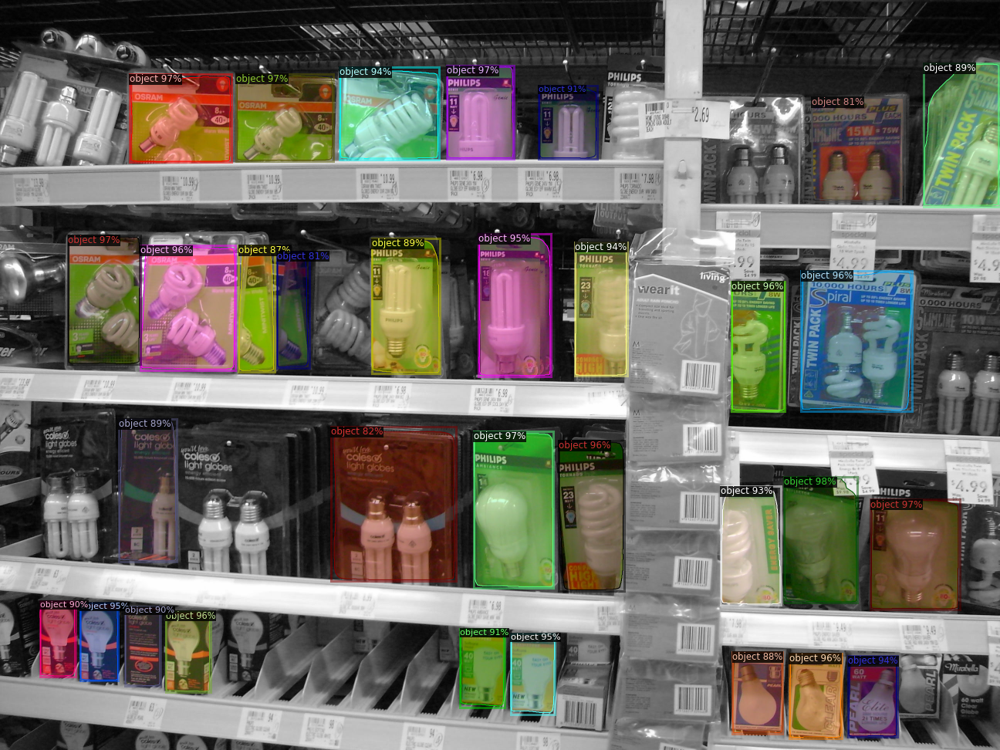

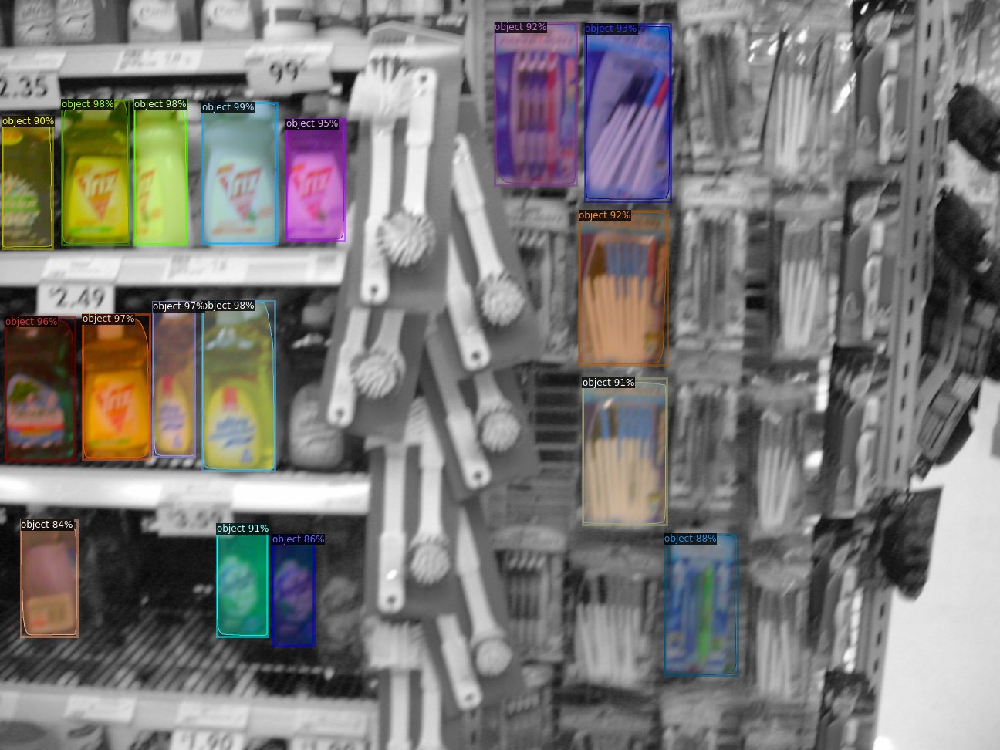

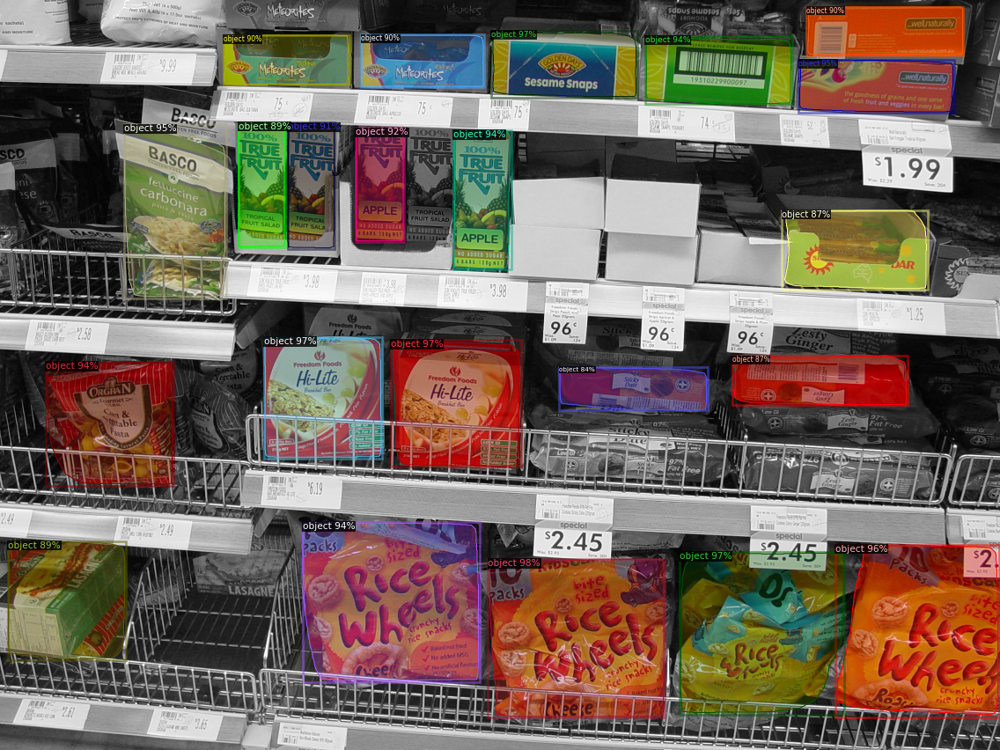

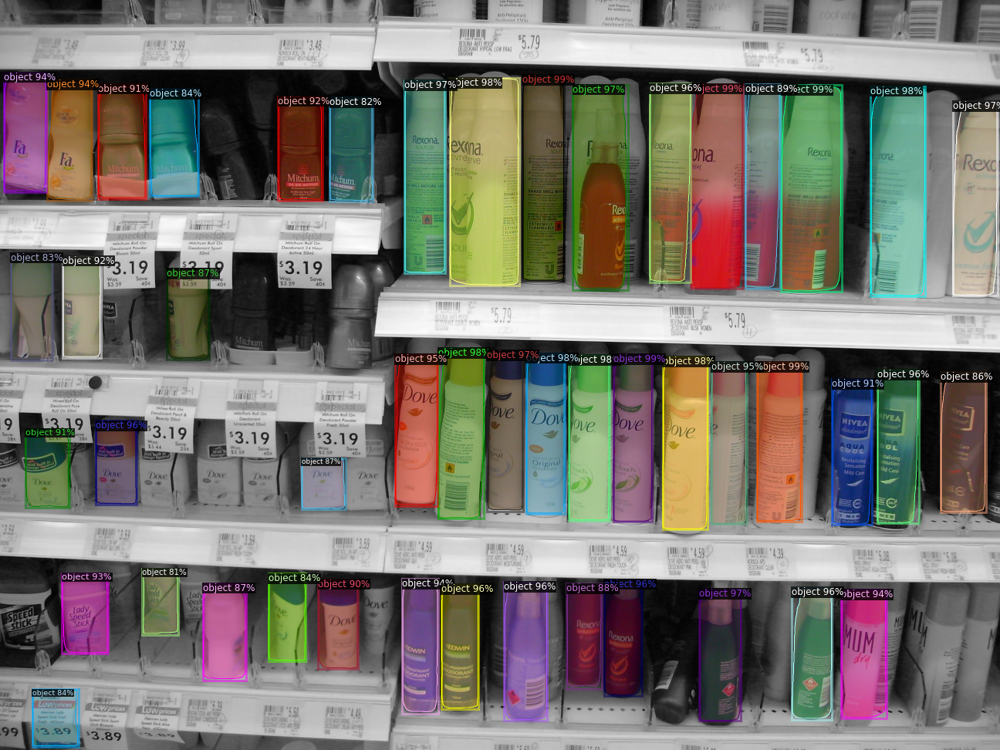

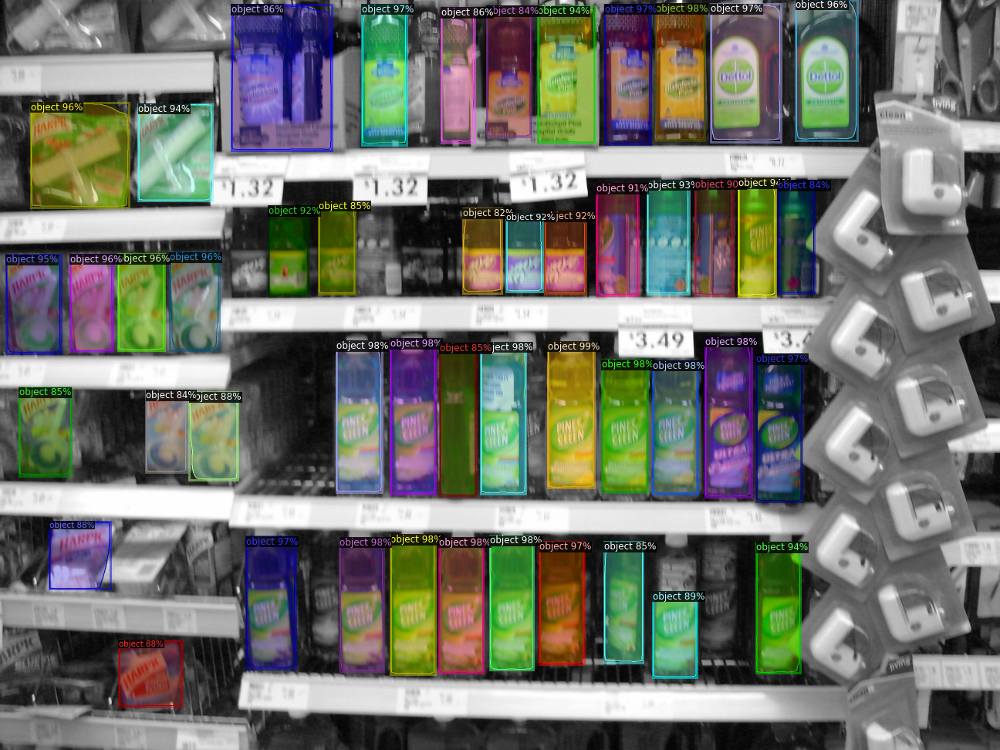

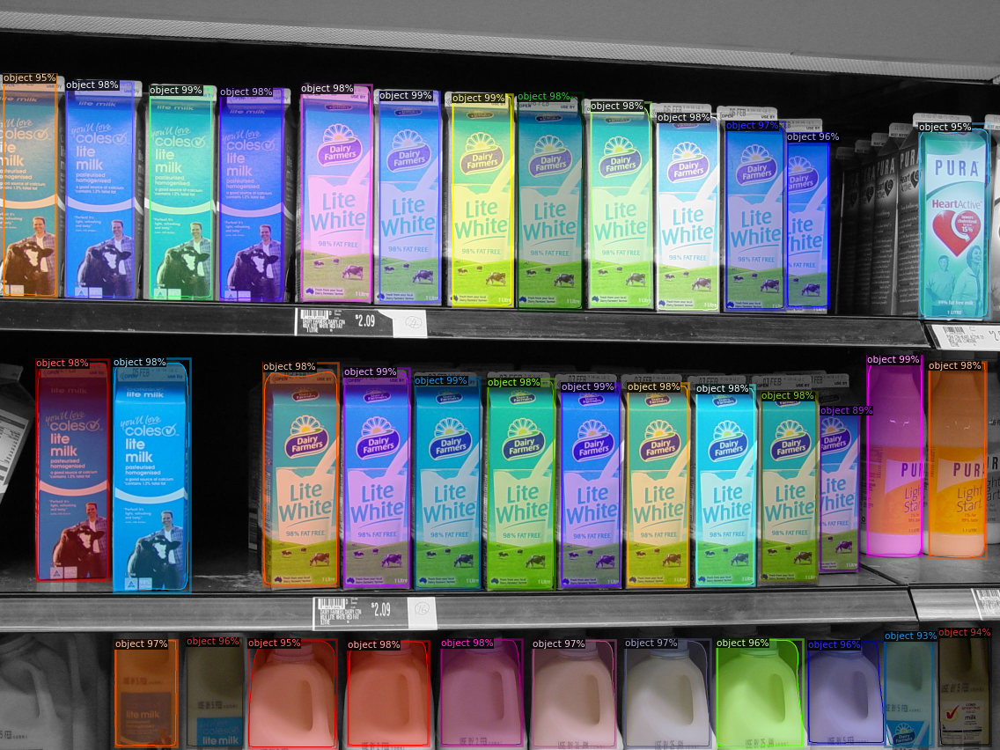

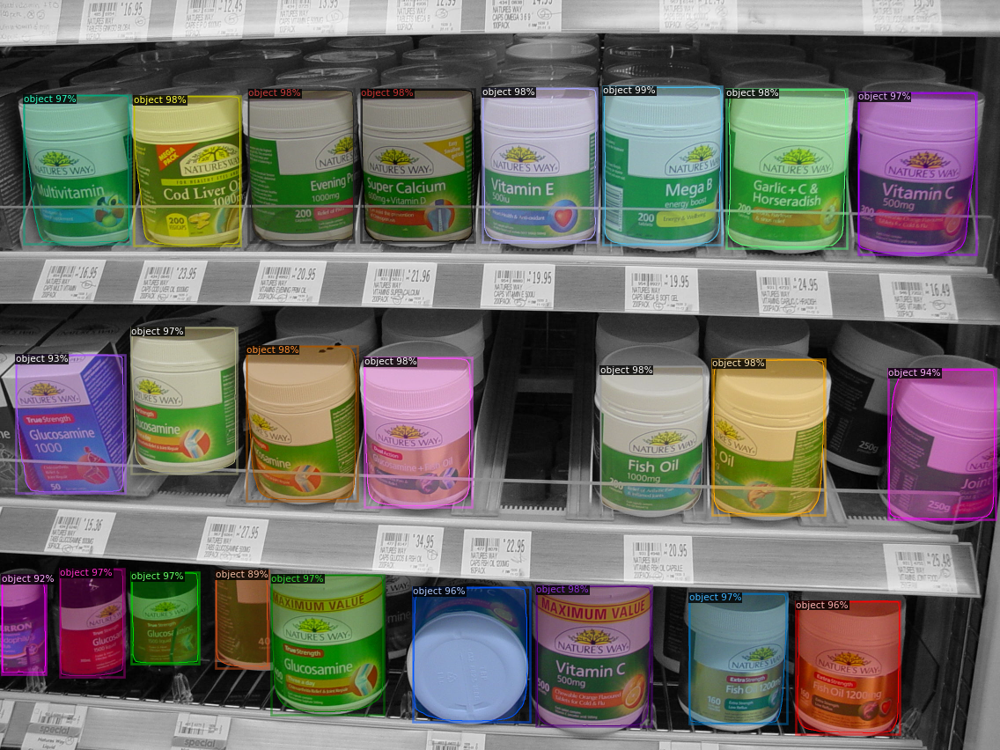

In [25]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = create_dataset_dicts(test_df, classes)
for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1],
                   metadata=statement_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

# **Inference on test set and storing the result**

In [26]:
evaluator = COCOEvaluator("objects_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "objects_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

[10/22 13:46:16 d2.data.common]: Serializing 316 elements to byte tensors and concatenating them all ...
[10/22 13:46:17 d2.data.common]: Serialized dataset takes 0.78 MiB
[10/22 13:46:17 d2.data.dataset_mapper]: Augmentations used in training: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/22 13:46:17 d2.evaluation.evaluator]: Start inference on 316 images
[10/22 13:46:28 d2.evaluation.evaluator]: Inference done 11/316. 0.2368 s / img. ETA=0:04:41
[10/22 13:46:34 d2.evaluation.evaluator]: Inference done 16/316. 0.2428 s / img. ETA=0:05:01
[10/22 13:46:39 d2.evaluation.evaluator]: Inference done 22/316. 0.2401 s / img. ETA=0:04:43
[10/22 13:46:45 d2.evaluation.evaluator]: Inference done 29/316. 0.2366 s / img. ETA=0:04:25
[10/22 13:46:51 d2.evaluation.evaluator]: Inference done 37/316. 0.2334 s / img. ETA=0:04:05
[10/22 13:46:56 d2.evaluation.evaluator]: Inference done 46/316. 0.2291 s / img. ETA=0:03:41
[10/22 13:47:02 d2.evaluation.evalua

OrderedDict([('bbox',
              {'AP': 46.85146579219775,
               'AP50': 85.12048243934754,
               'AP75': 46.360740460715824,
               'APl': 48.383905511330354,
               'APm': 13.416687301035745,
               'APs': 0.0}),
             ('segm',
              {'AP': 46.91964381034838,
               'AP50': 85.22708234210701,
               'AP75': 46.836018673526624,
               'APl': 48.33663555896234,
               'APm': 12.622909788070915,
               'APs': 0.0})])

In [28]:
os.makedirs("annotated_results", exist_ok=True)
test_image_paths = test_df.file_path.unique()

In [30]:
for test_image in test_image_paths:
  im = cv2.imread(test_image)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata, 
    scale=0.5, 
    instance_mode=ColorMode.IMAGE_BW
  )
  instances = outputs["instances"].to("cpu")
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(test_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

In [32]:
!ls annotated_results

db1002.jpg  db1534.jpg	db1959.jpg  db2397.jpg	db2822.jpg  db455.jpg
db1006.jpg  db155.jpg	db1962.jpg  db2407.jpg	db2823.jpg  db461.jpg
db101.jpg   db1561.jpg	db1980.jpg  db2418.jpg	db2825.jpg  db466.jpg
db1023.jpg  db1566.jpg	db1.jpg     db2419.jpg	db282.jpg   db488.jpg
db1039.jpg  db1573.jpg	db2004.jpg  db2420.jpg	db2835.jpg  db512.jpg
db103.jpg   db1583.jpg	db2015.jpg  db242.jpg	db2858.jpg  db516.jpg
db1040.jpg  db1615.jpg	db2017.jpg  db2430.jpg	db2874.jpg  db51.jpg
db1069.jpg  db1620.jpg	db2024.jpg  db2439.jpg	db2880.jpg  db532.jpg
db1086.jpg  db1624.jpg	db2034.jpg  db245.jpg	db2898.jpg  db536.jpg
db108.jpg   db1636.jpg	db2035.jpg  db2468.jpg	db2909.jpg  db547.jpg
db110.jpg   db1646.jpg	db2058.jpg  db2475.jpg	db2911.jpg  db552.jpg
db1126.jpg  db1669.jpg	db2061.jpg  db2502.jpg	db2926.jpg  db553.jpg
db1143.jpg  db1678.jpg	db2073.jpg  db2509.jpg	db2927.jpg  db565.jpg
db1173.jpg  db1681.jpg	db2077.jpg  db2516.jpg	db2929.jpg  db569.jpg
db1174.jpg  db1687.jpg	db2086.jpg  db2527.jpg	db2935

In [33]:
annotated_images = [f'annotated_results/{f}' for f in test_df.image_name.unique()]

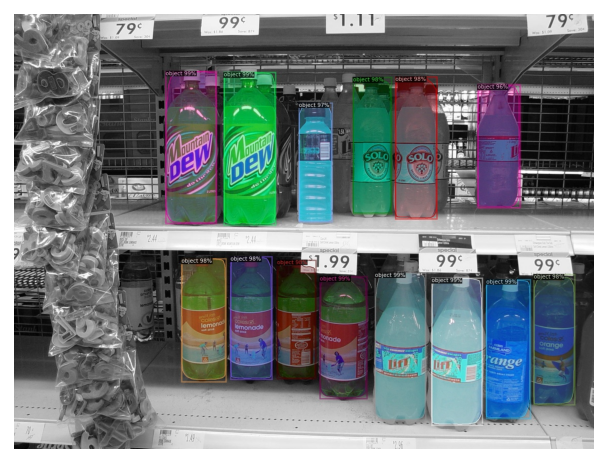

In [45]:
img = cv2.imread(annotated_images[67])

plt.imshow(img)
plt.axis('off');

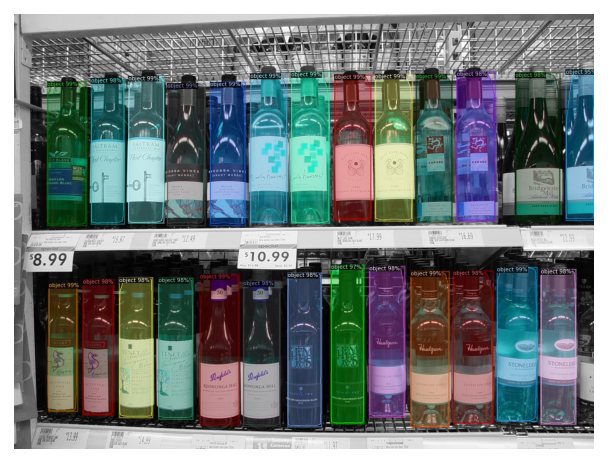

In [50]:
random_sample = random.sample(annotated_images, 1)
img = cv2.imread(random_sample[0])

plt.imshow(img)
plt.axis('off');